In [1]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format='retina'

In [2]:
import os
import json

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from tqdm import tqdm

import torch
import torchvision

import anndata
import scanpy as sc

In [3]:
import deepmorph.vqvae.vqvae
import deepmorph.data.dataset

In [4]:
args = {
    'output_path': 'test_output', 
    'device' : 'cuda',
    'train_data_path' : '/home/xingjiepan/Data/20230313_deep_morph_test_data_splitted/train',
    'validation_data_path': '/home/xingjiepan/Data/20230313_deep_morph_test_data_splitted/validation',
    'fiducial_channel': 3, # The channel ID of DAPI
    'n_categories' : 37, # Number of protein channels
    'n_conditions' : 4, # Number of cell conditions
    'img_xy_shape' : (128, 128),
    'normalization_factor' : 1,
    'batch_size' : 64,
    'lr': 3e-4,
    'anneal_lr': True,
    'epoch': 100,
    'n_stop_threhold': 20,
    }

pretrained_dict = torch.load(os.path.join(args['output_path'], 'check_points', 'vqvae_best.pt'))
pretrained_dict = {key.replace("module.", ""): value for key, value in pretrained_dict.items()}

model = deepmorph.vqvae.vqvae.VQVAE(in_channel=2,
                                    channel=32,
                                    n_res_block=2,
                                    n_res_channel=16,
                                    embed_dim=32,
                                    n_embed=256,
                                    classifier_hidden_dim=512, 
                                    n_categories=args['n_categories'], 
                                    n_conditions=args['n_conditions'],
                                    img_xy_shape=args['img_xy_shape'])

model.load_state_dict(pretrained_dict)


device = 'cpu'
model.to(device)
model.eval()
pass

In [5]:
channel_names = ['ATF4', 'Calreticulin', 'Coilin', 'DAPI', 'Fibrillarin', 'G3BP',
       'GAPDH', 'GM130', 'H3K27ac', 'Hsc70', 'Hsp60', 'Ki-67', 'LC3b',
       'Lamin-A', 'Lamp1', 'M6PR', 'M6PR-2', 'NFkB p65', 'Na+/K+ ATPase',
       'P-eIF4E', 'PARP', 'PML', 'Plectin', 'RAB7', 'RNAPII', 'Rab4',
       'SF3a66', 'SNAP23', 'Sec24c', 'Sqstm1', 'TOM70', 'TOMM20',
       'Tubulin', 'Vimentin', 'alpha-Actinin', 'cathepsin B', 'p-S6RP']

dataset = deepmorph.data.dataset.DiskDataset('/home/xingjiepan/Data/20230313_deep_morph_test_data_splitted/test',
                                            normalize_img=False)
loader = torch.utils.data.DataLoader(dataset, 256, shuffle=False, num_workers=0)

In [6]:
with torch.no_grad():
    sample = torch.tensor([dataset[-100][0]], dtype=torch.float32)
    vec_t, vec_b, _, _, _ = model.encode(torch.cat((sample.reshape(37, 1, 128, 128), 
                    torch.repeat_interleave(sample[:, [3], :, :], sample.shape[1], dim=0)), 
                                      dim=1))

<ipython-input-6-172cb28ab4bd>:2: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /opt/conda/conda-bld/pytorch_1670525539683/work/torch/csrc/utils/tensor_new.cpp:230.)
  sample = torch.tensor([dataset[-100][0]], dtype=torch.float32)


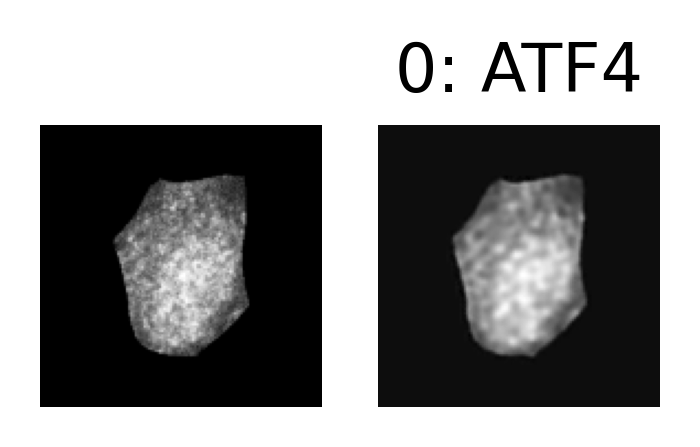

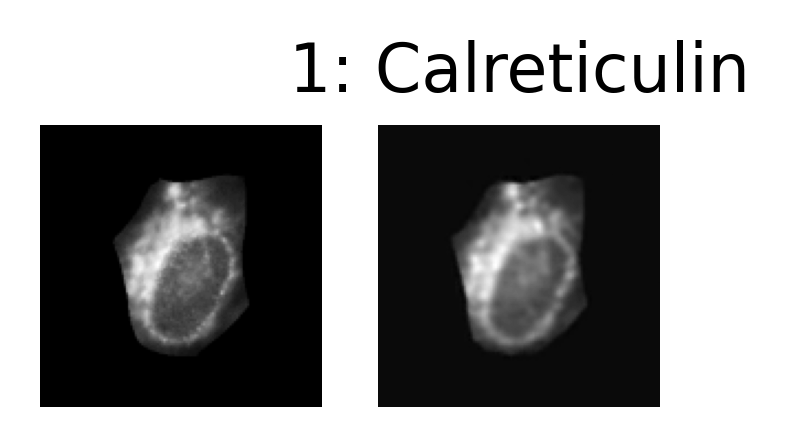

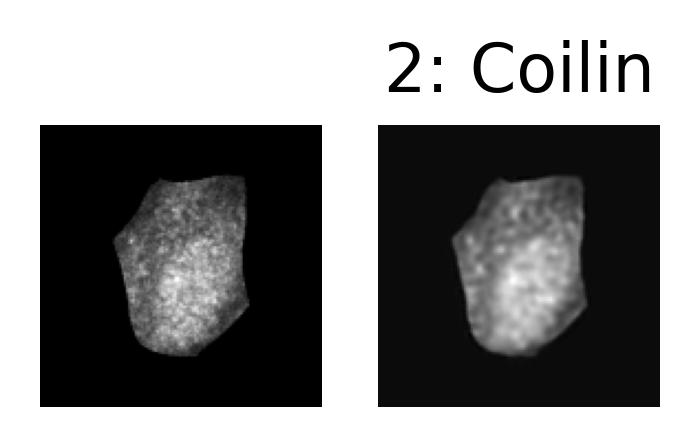

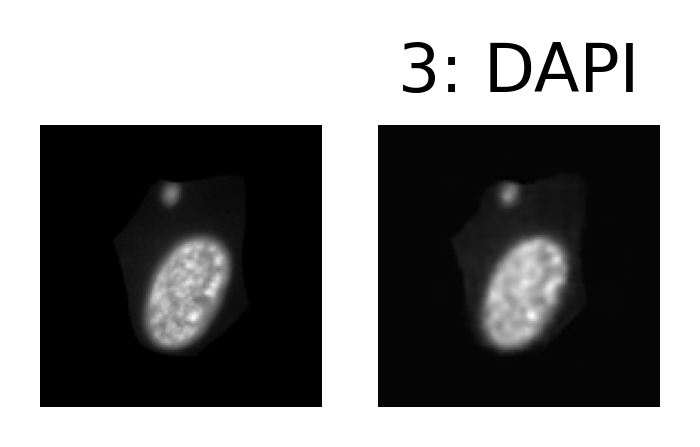

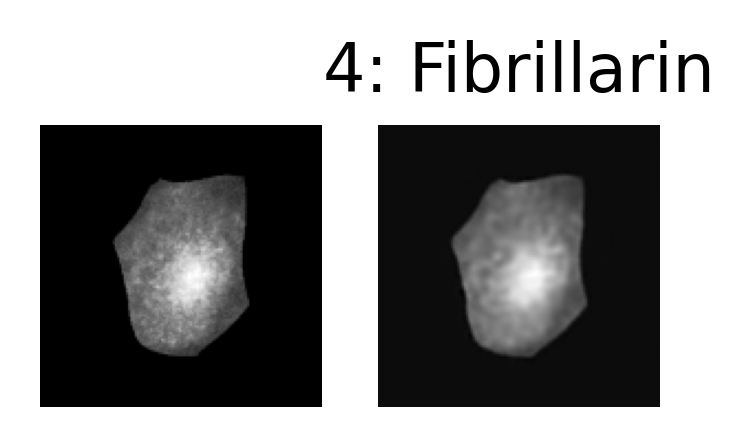

...

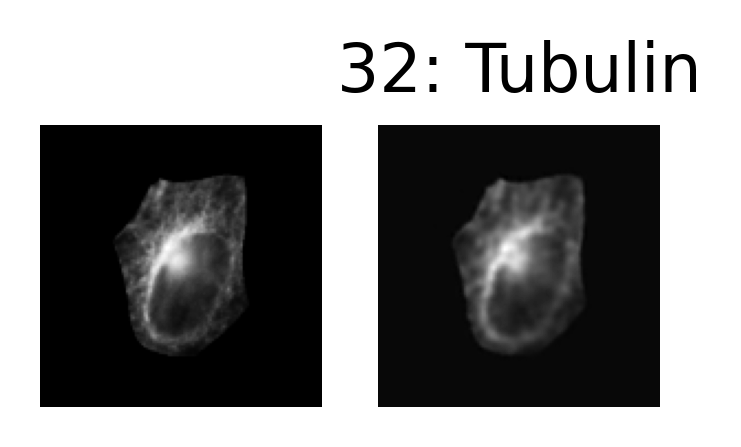

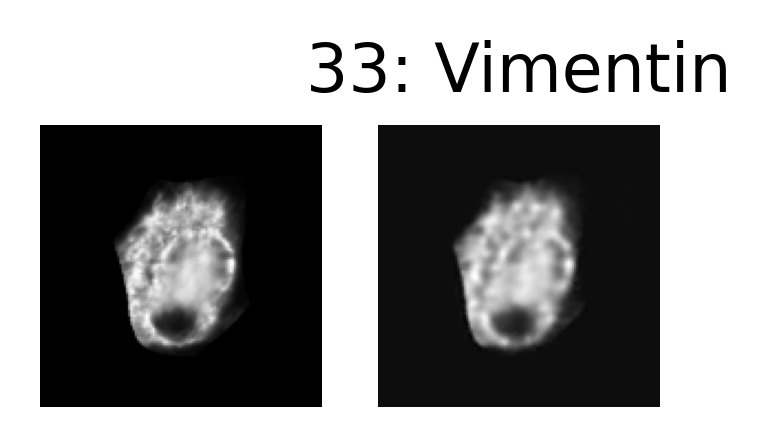

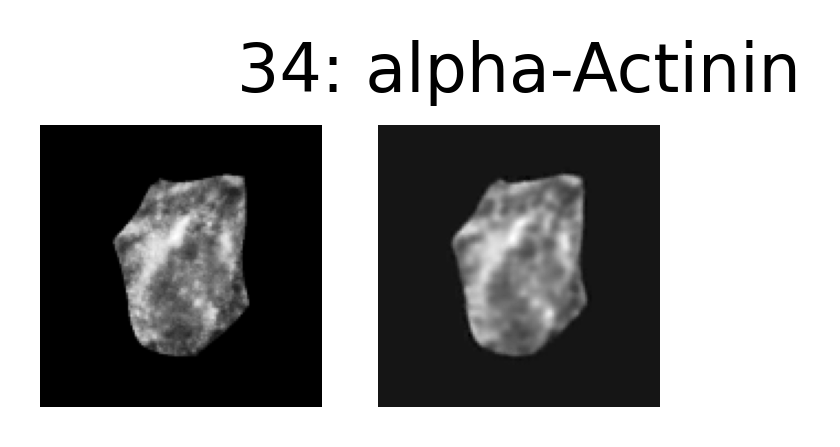

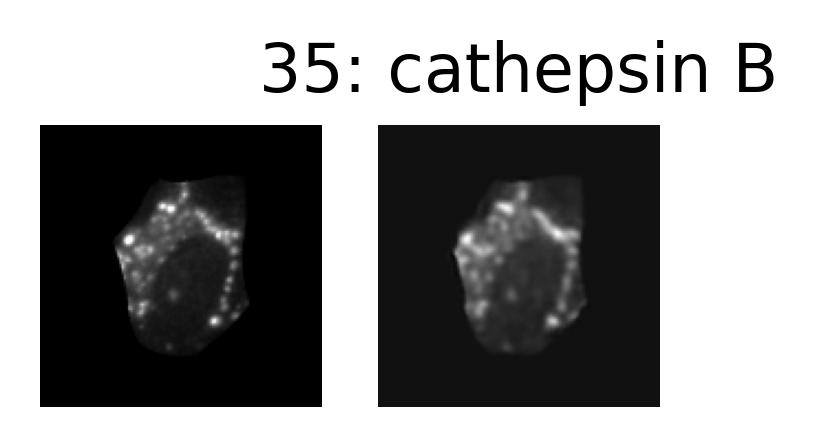

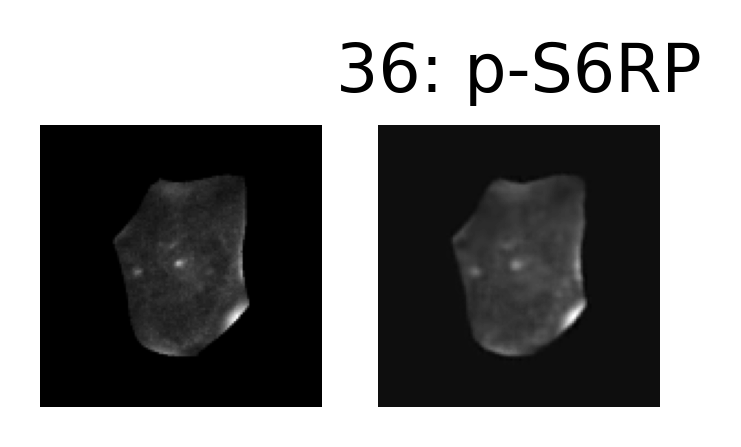

In [7]:
with torch.no_grad():
    sample = torch.tensor([dataset[-100][0]], dtype=torch.float32)
    output, _, _, _ = model(torch.cat((sample.reshape(37, 1, 128, 128), 
                    torch.repeat_interleave(sample[:, [3], :, :], sample.shape[1], dim=0)), 
                                      dim=1))

for i in range(sample.shape[1]):
    fig, axes = plt.subplots(1, 2, figsize=(2, 1), dpi=200)
        
    axes[0].imshow(sample[0, i], cmap='gray')
    axes[1].imshow(output[i, 0], cmap='gray')
    
    axes[0].set_axis_off()
    axes[1].set_axis_off()
    
    plt.title(str(i) + ': ' + channel_names[i])
    plt.show()


# Get the classifier embedding

In [8]:
import umap.umap_ as umap
import plotly.express as px

In [9]:
def split_protein_channels(img, y, fiducial_channel):
    '''Split stacks of cell images by protein channels'''
    n_protein_channels = img.shape[1]
    img_split = img.reshape(img.shape[0] * img.shape[1], 1, img.shape[2], img.shape[3])
    img_fiducial = torch.repeat_interleave(img[:, [fiducial_channel], :, :], img.shape[1], dim=0)
    
    protein_ids = []
    condition_ids = []
    for i in range(img.shape[0]):
        for j in range(n_protein_channels):
            protein_ids.append(j)
            condition_ids.append(y[i])
    
    return torch.cat((img_split, img_fiducial), dim=1), protein_ids, condition_ids

In [10]:
loader = tqdm(loader)

p_embedding = []
protein_ids = []
condition_ids = []
cell_ids = []
cell_counter = 0

for i, (img, label) in enumerate(loader):
    for k in range(img.shape[0]):
        for kk in range(img.shape[1]):
            cell_ids.append(cell_counter)
        cell_counter += 1
    
    # Embed the protein features
    img, p_ids, c_ids = split_protein_channels(img, label, 3)
    img = img.to(device, dtype=torch.float32)
    
    vec_t, vec_b, _, _, _ = model.encode(img)
    
    z_features = torch.cat((model.flatten(vec_t), model.flatten(vec_b)), dim=1)            
    emb_p = model.classifier_p.generate_embedding(z_features)
        
    for j in range(emb_p.shape[0]):
        p_embedding.append(emb_p[j].detach().cpu().numpy())
        protein_ids.append(p_ids[j])
        condition_ids.append(c_ids[j])
    
p_embedding = np.array(p_embedding)
protein_ids = np.array(protein_ids)
condition_ids = np.array(condition_ids)
cell_ids = np.array(cell_ids)

100%|██████████| 23/23 [08:06<00:00, 21.16s/it]


In [11]:
adata_p = anndata.AnnData(
    X=p_embedding,
    obs=pd.DataFrame({'cell_id' : cell_ids, 
                      'condition' : [dataset.categories[c] for c in condition_ids], 
                      'protein' : [channel_names[p] for p in protein_ids]})
)

adata_p

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 211418 × 512
    obs: 'cell_id', 'condition', 'protein'

# UMAP of all protein channels

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


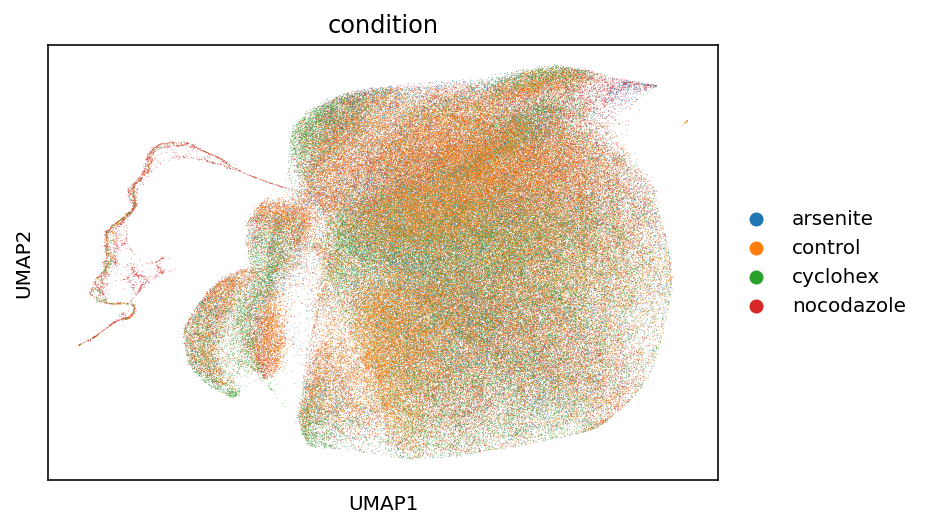

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


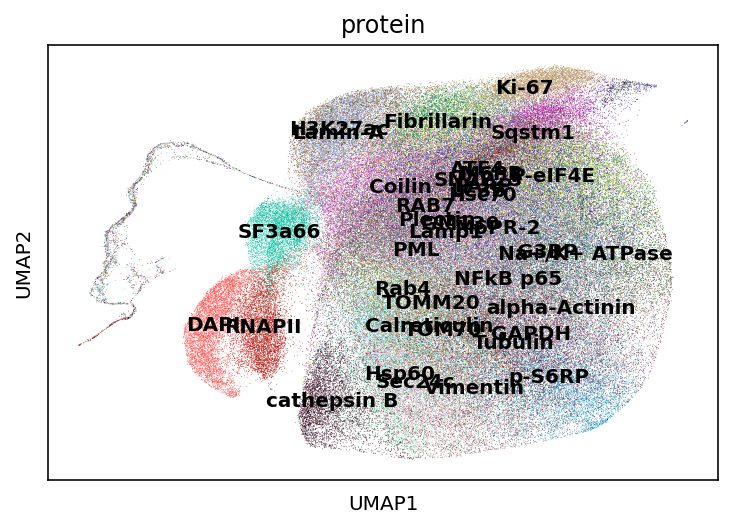

In [22]:
sc.tl.pca(adata_p, n_comps=50)
sc.pp.neighbors(adata_p, n_pcs=50, n_neighbors=30)

sc.tl.umap(adata_p)
sc.pl.umap(adata_p, color='condition')
sc.pl.umap(adata_p, color='protein', legend_loc='on data')

# UMAPs of individual protein channels

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


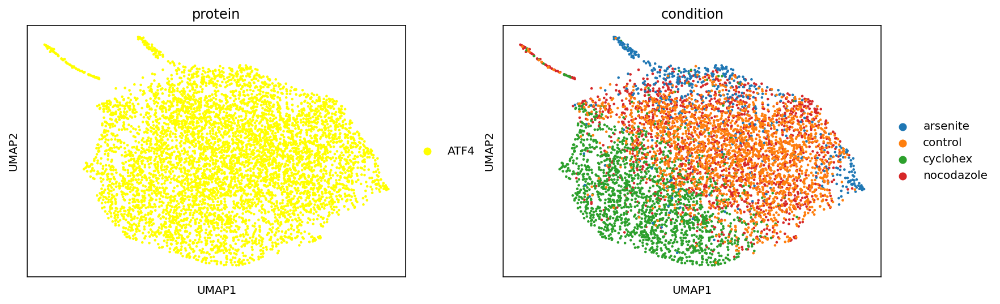

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


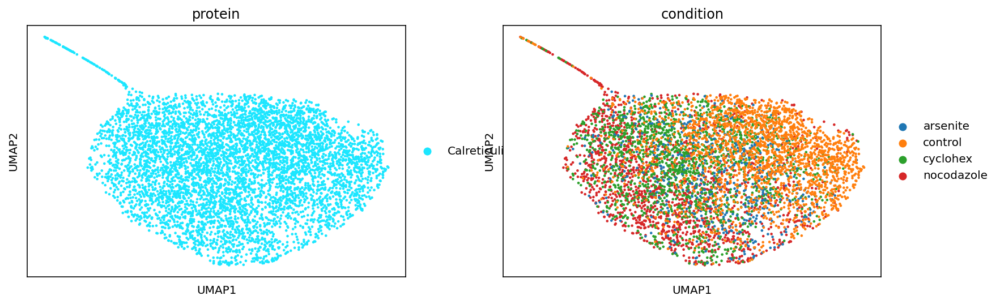

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


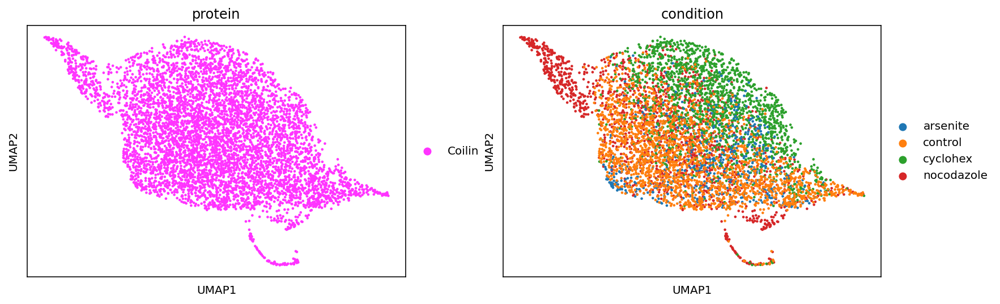

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


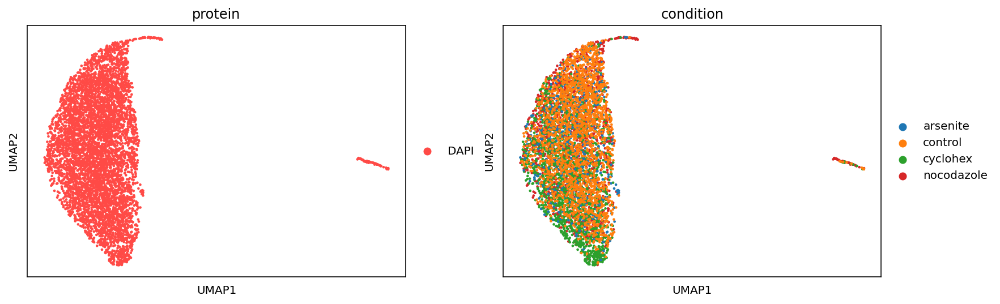

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


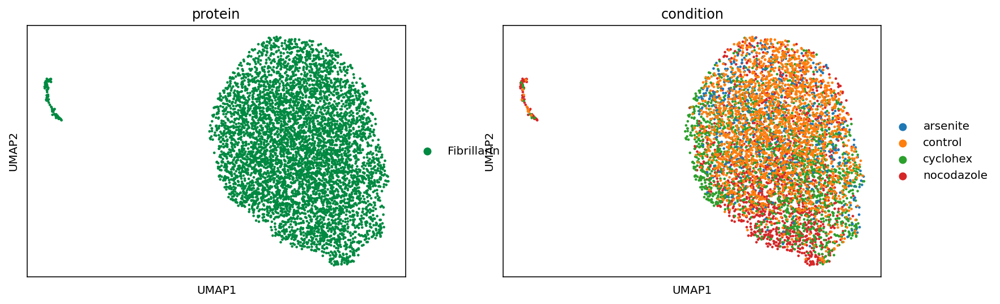

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


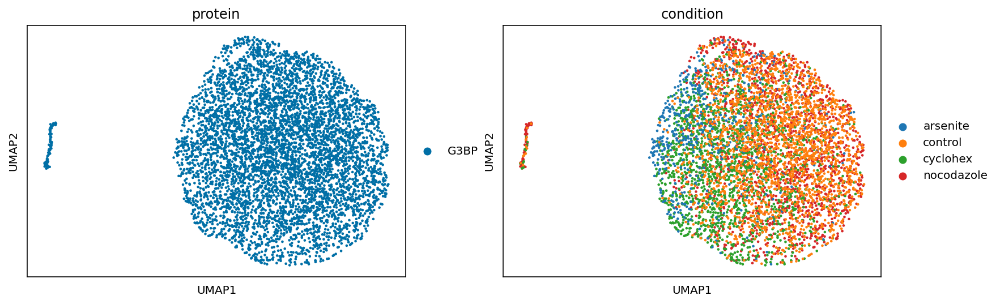

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


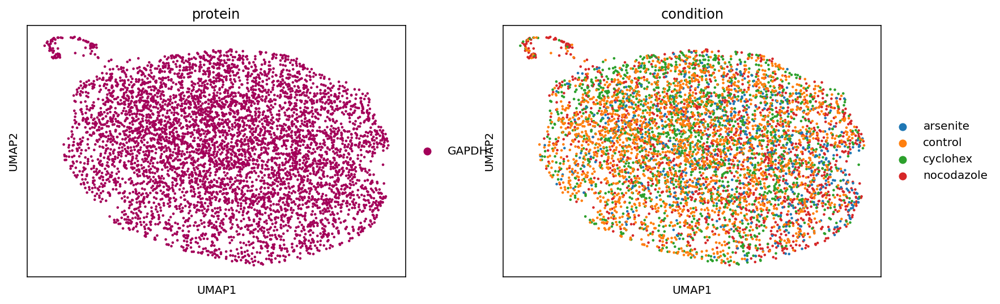

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


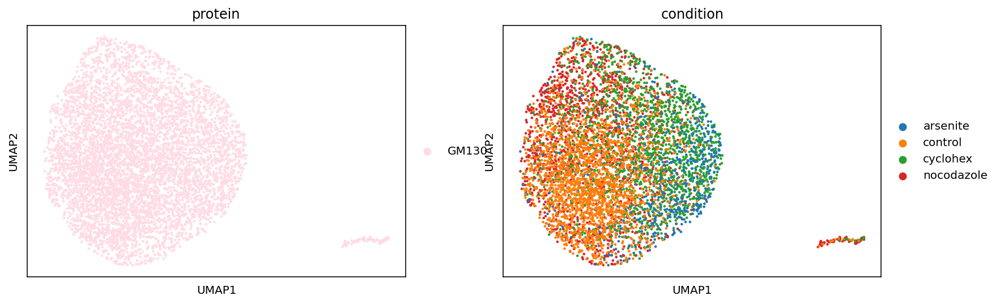

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


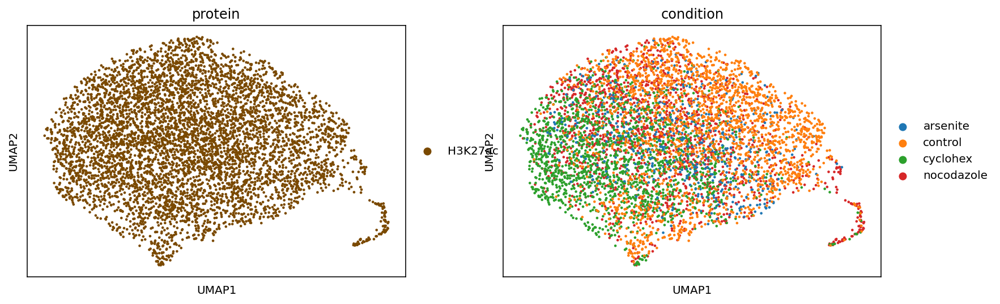

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


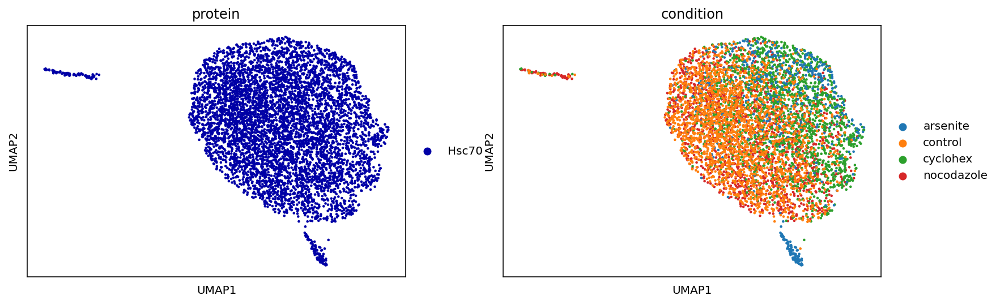

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


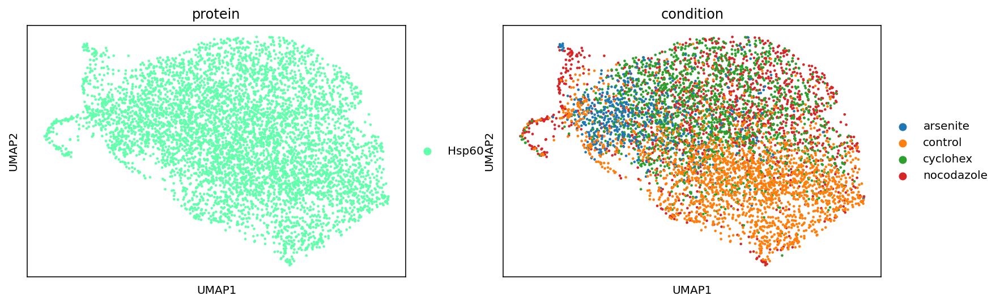

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


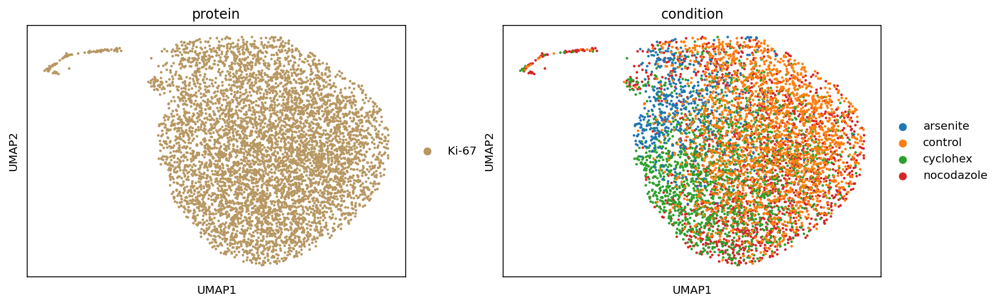

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


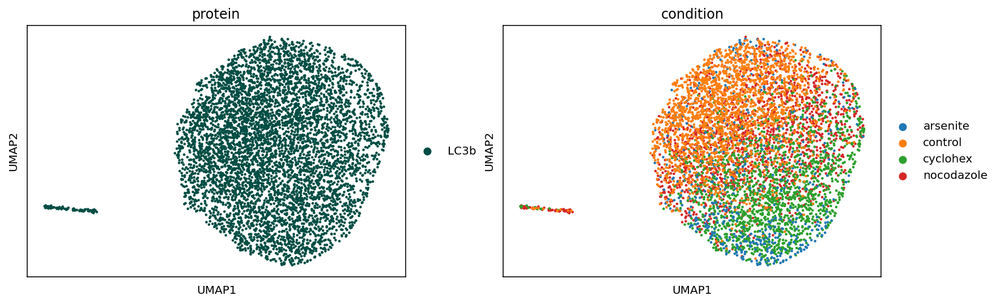

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


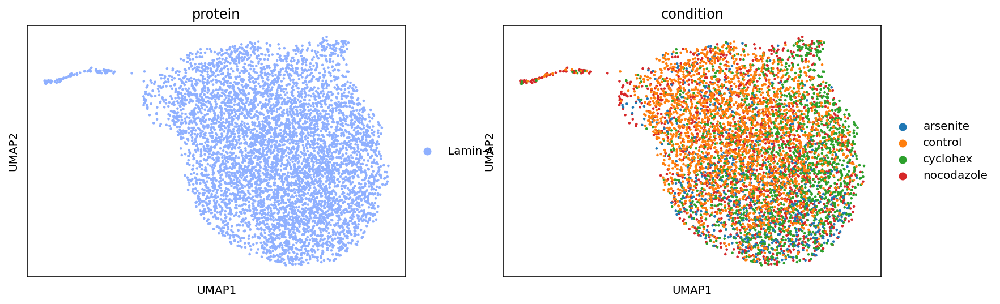

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


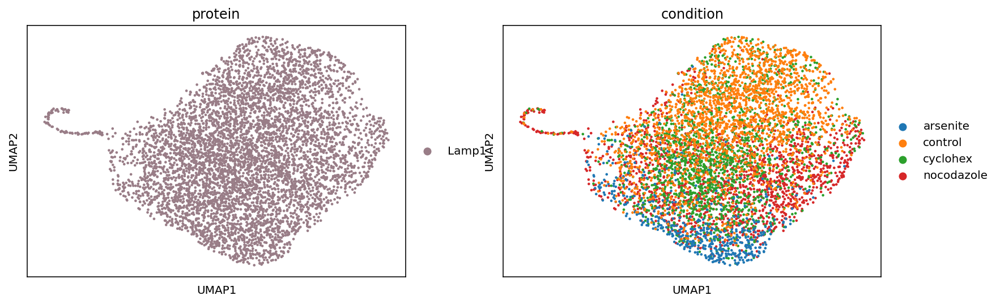

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


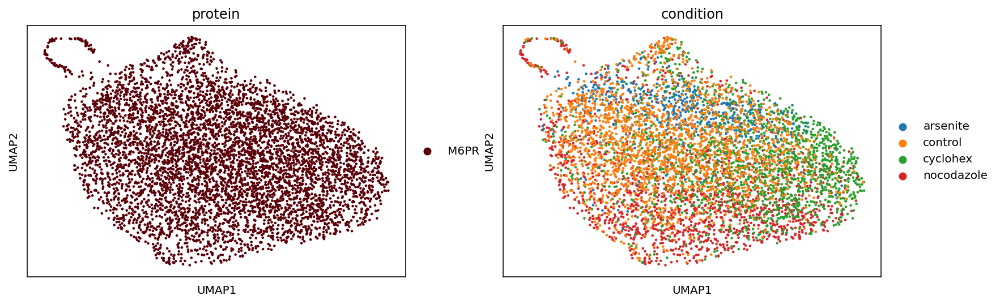

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


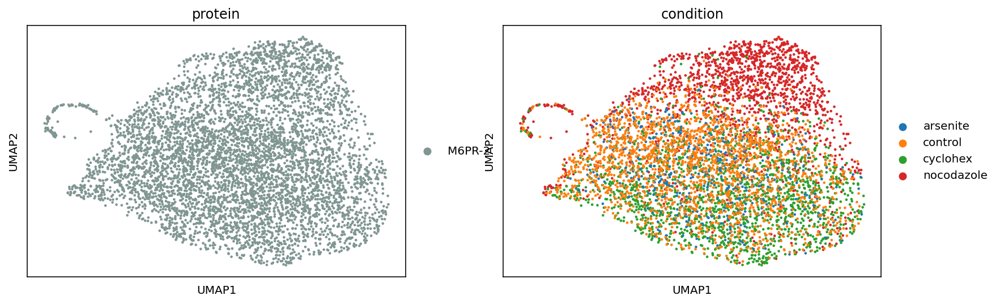

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


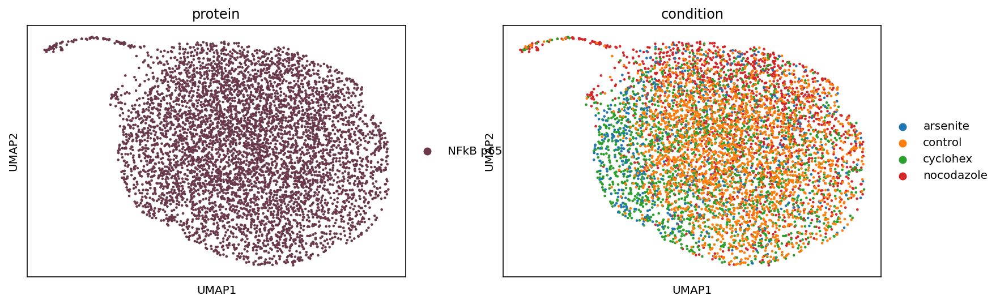

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


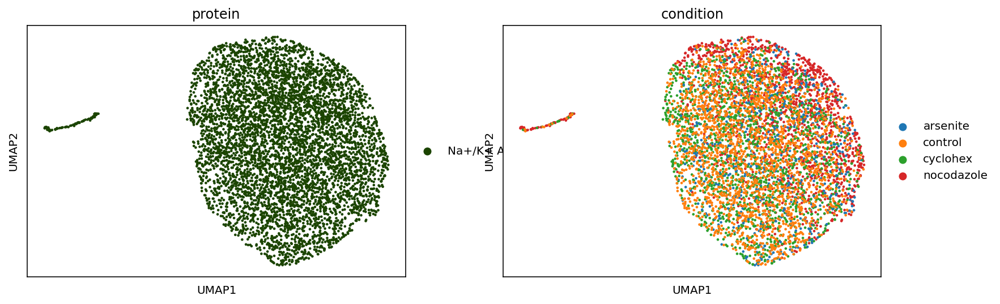

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


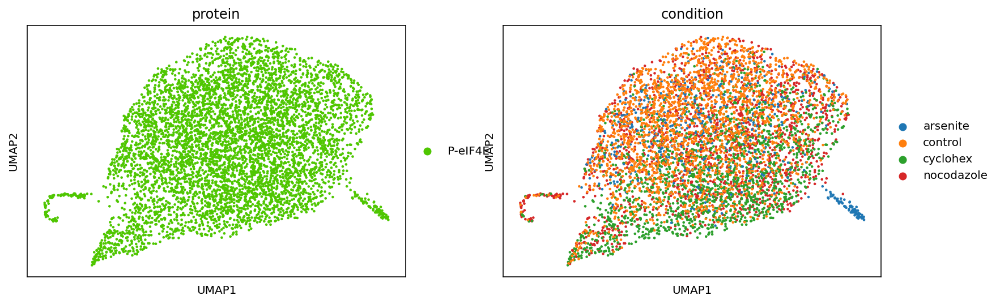

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


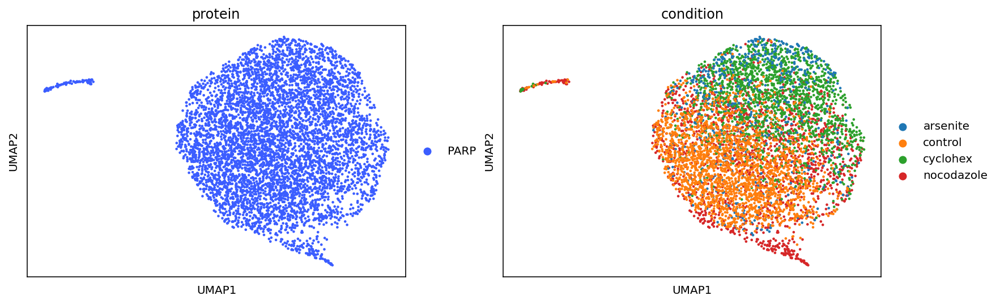

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


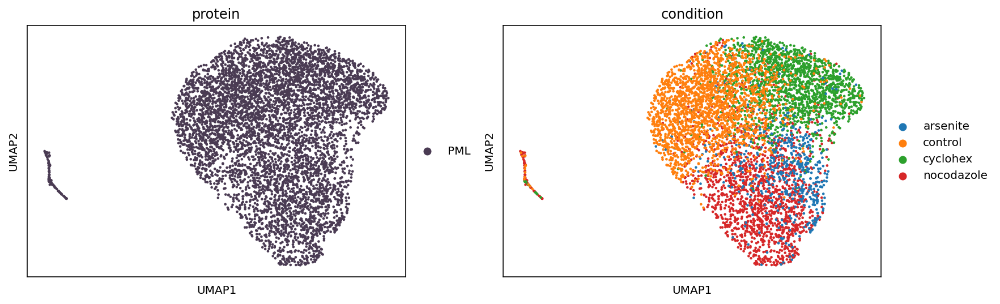

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


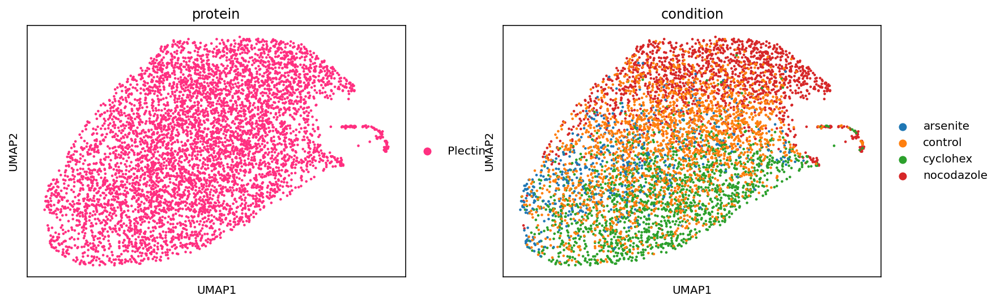

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


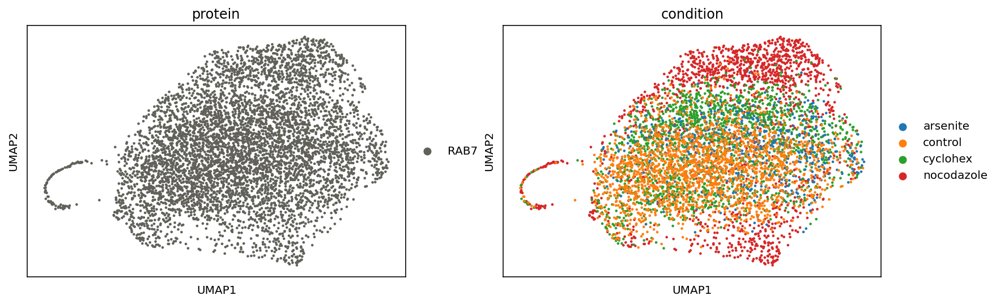

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


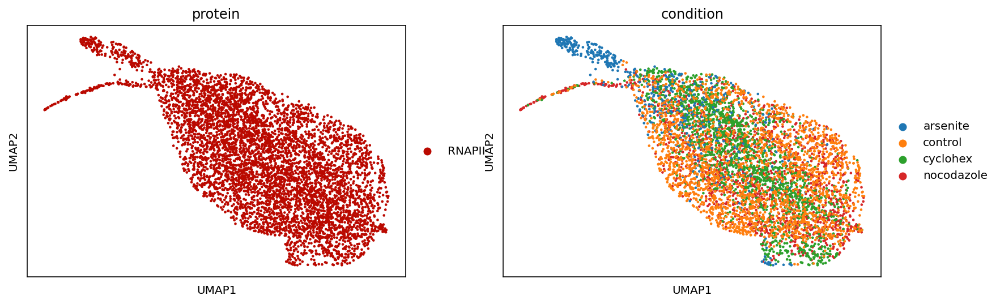

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


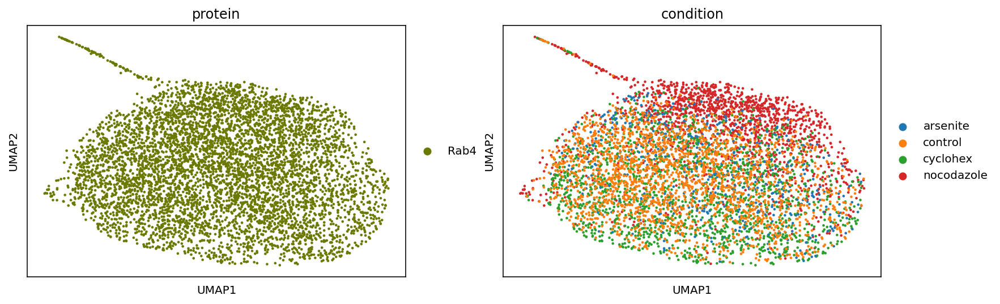

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


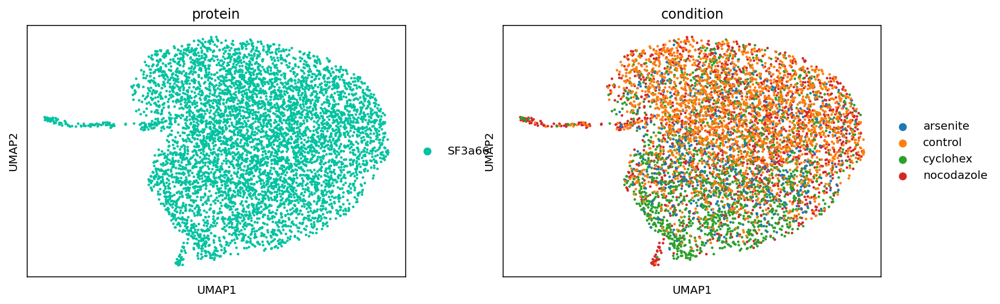

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


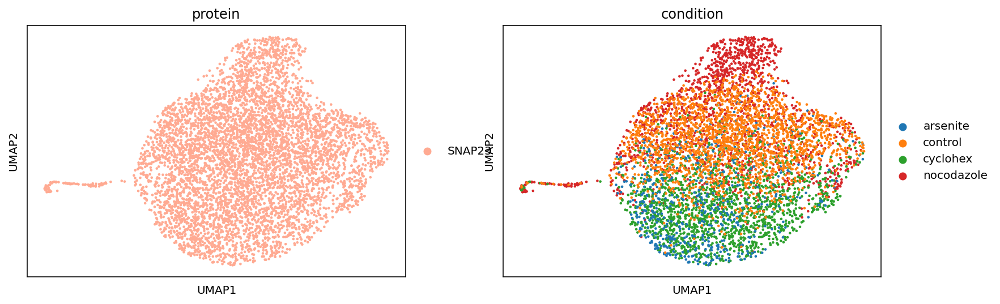

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


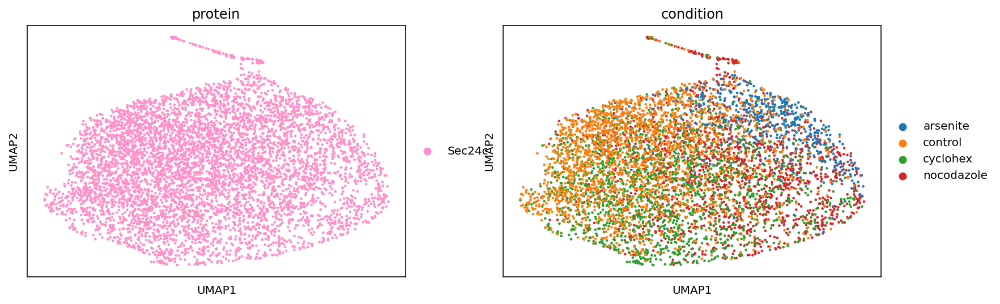

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


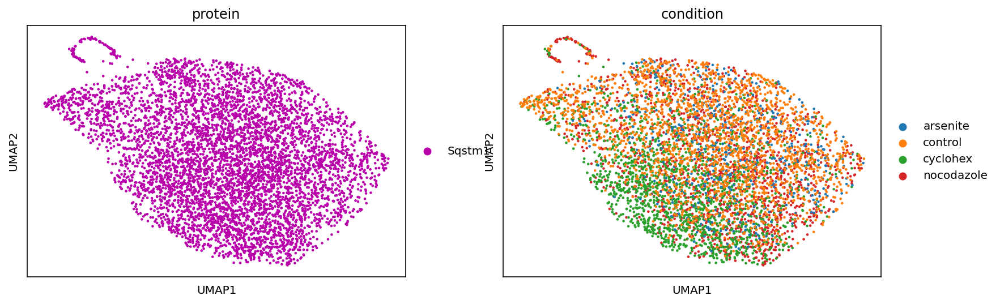

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


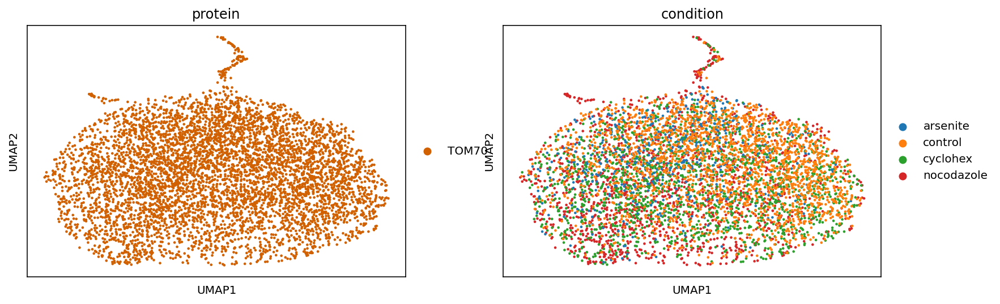

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


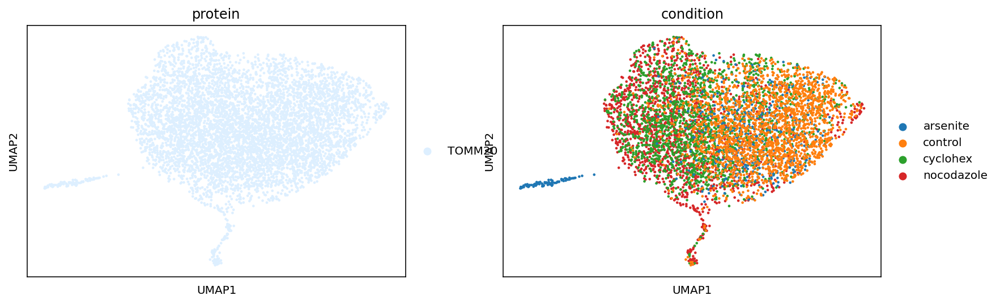

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


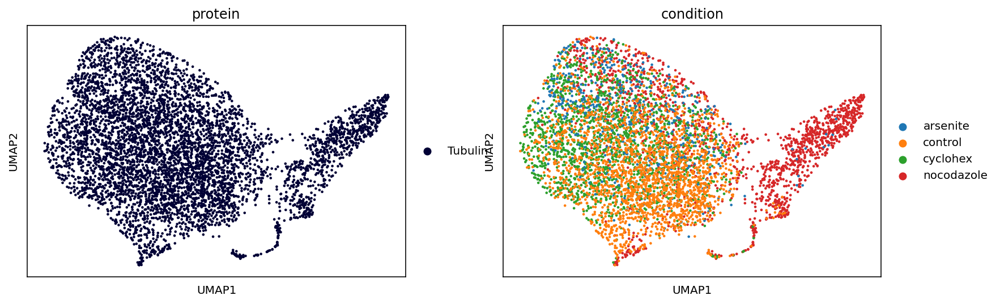

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


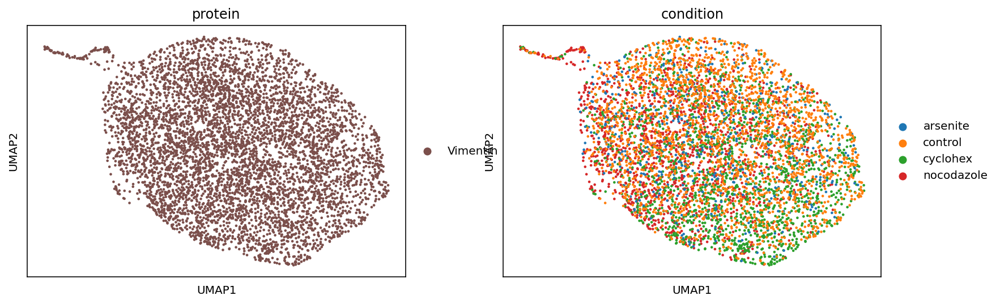

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


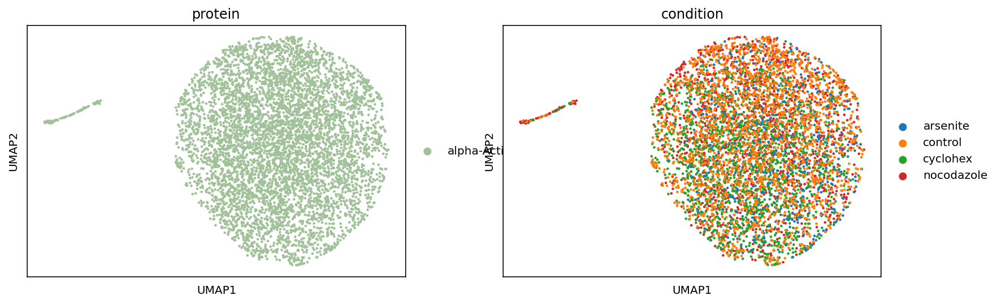

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


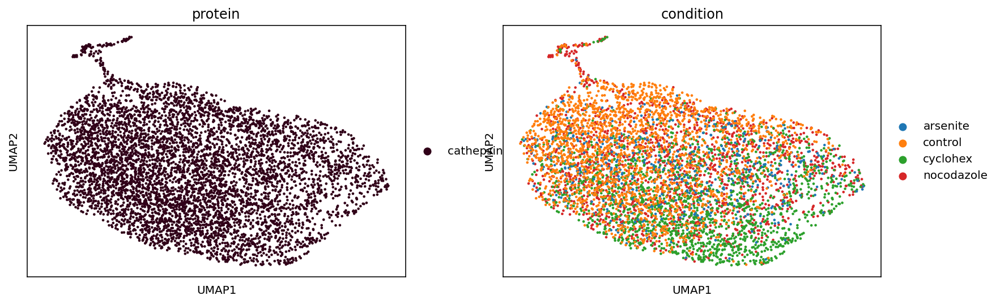

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


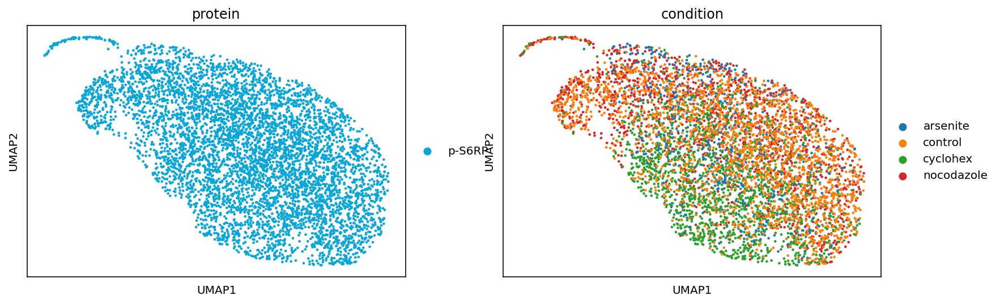

In [35]:
for p in np.unique(adata_p.obs['protein']):
    adata_p_single = adata_p[adata_p.obs['protein'] == p].copy()
    
    sc.tl.pca(adata_p_single, n_comps=50)
    sc.pp.neighbors(adata_p_single, n_pcs=50, n_neighbors=30)
    
    sc.tl.umap(adata_p_single)
    sc.pl.umap(adata_p_single, color=['protein', 'condition'])

# UMAP of combined cells

In [28]:
# Generate cell embeddings from protein embeddings
n_protein_channels = 37
c_embedding = p_embedding.reshape((-1, p_embedding.shape[1] * n_protein_channels))
c_cell_ids = cell_ids[::n_protein_channels]
c_condition_ids = condition_ids[::n_protein_channels]

In [30]:
adata_c = anndata.AnnData(
    X=c_embedding,
    obs=pd.DataFrame({'cell_id' : c_cell_ids, 
                      'condition' : [dataset.categories[c] for c in c_condition_ids]})
)

adata_c.obs['cell_name'] = [os.path.basename(dataset.files[i]).split('.')[0] 
                            for i in adata_c.obs['cell_id']]

adata_c

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 5714 × 18944
    obs: 'cell_id', 'condition', 'cell_name'

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


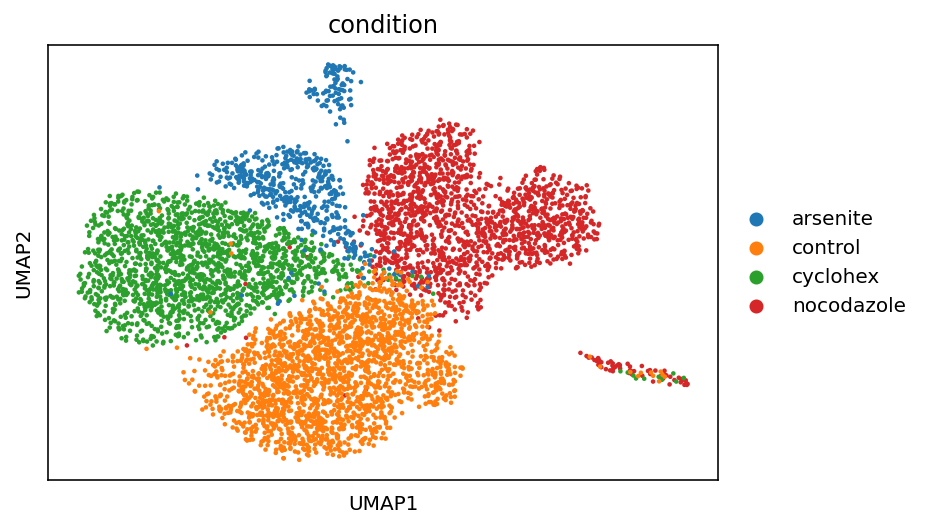

In [31]:
sc.tl.pca(adata_c, n_comps=50)
sc.pp.neighbors(adata_c, n_pcs=50, n_neighbors=30, )

sc.tl.umap(adata_c, min_dist=0.8)
sc.pl.umap(adata_c, color='condition')

# Plot example images of protein channels

In [36]:
channel_names = ['ATF4', 'Calreticulin', 'Coilin', 'DAPI', 'Fibrillarin', 'G3BP',
       'GAPDH', 'GM130', 'H3K27ac', 'Hsc70', 'Hsp60', 'Ki-67', 'LC3b',
       'Lamin-A', 'Lamp1', 'M6PR', 'M6PR-2', 'NFkB p65', 'Na+/K+ ATPase',
       'P-eIF4E', 'PARP', 'PML', 'Plectin', 'RAB7', 'RNAPII', 'Rab4',
       'SF3a66', 'SNAP23', 'Sec24c', 'Sqstm1', 'TOM70', 'TOMM20',
       'Tubulin', 'Vimentin', 'alpha-Actinin', 'cathepsin B', 'p-S6RP']

In [45]:
np.unique(adata_p.obs['condition'])

array(['arsenite', 'control', 'cyclohex', 'nocodazole'], dtype=object)

/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/xingjiepan/Softwares/Conda/anaconda3/envs/perturb_fish/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


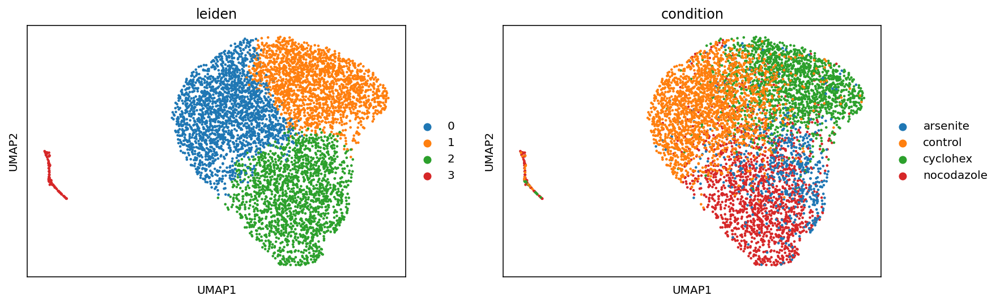

In [71]:
protein_to_show = 'PML'

adata_p_single = adata_p[adata_p.obs['protein'] == protein_to_show].copy()
    
sc.tl.pca(adata_p_single, n_comps=50)
sc.pp.neighbors(adata_p_single, n_pcs=50, n_neighbors=30)

sc.tl.leiden(adata_p_single, resolution=0.2)
sc.tl.umap(adata_p_single)
sc.pl.umap(adata_p_single, color=['leiden', 'condition'])

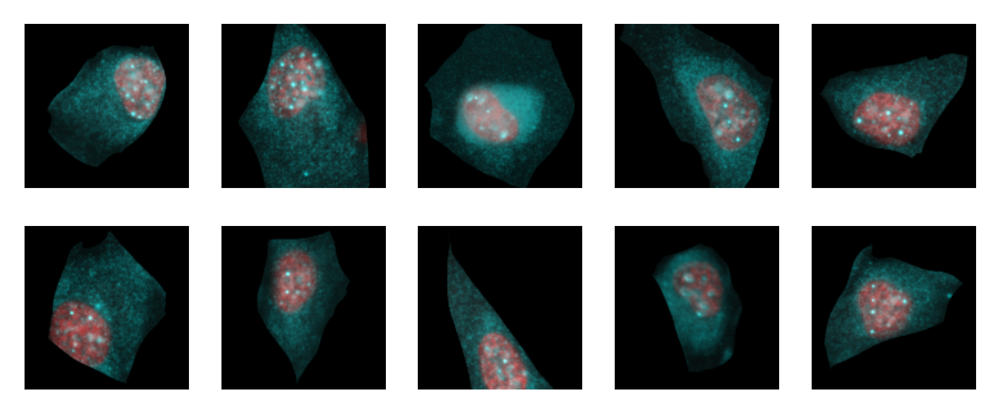

In [75]:
cluster_to_show = '1'

cell_ids_to_show = adata_p_single.obs[
    (adata_p_single.obs['protein'] == protein_to_show)
    &(adata_p_single.obs['leiden'] == cluster_to_show)]['cell_id'].values[:]

np.random.shuffle(cell_ids_to_show)
cell_ids_to_show = cell_ids_to_show[:10]

protein_id = channel_names.index(protein_to_show)
N_cells = len(cell_ids_to_show)

fig, axes = plt.subplots(2, 5, figsize=(5, 2), dpi=200)

for i in range(2):
    for j in range(5):
        cell_id = cell_ids_to_show[i * 5 + j]
        axes[i, j].imshow(np.array([dataset[cell_id][0][3], dataset[cell_id][0][protein_id], 
                    dataset[cell_id][0][protein_id]]).transpose(1, 2, 0))
        axes[i, j].set_axis_off()

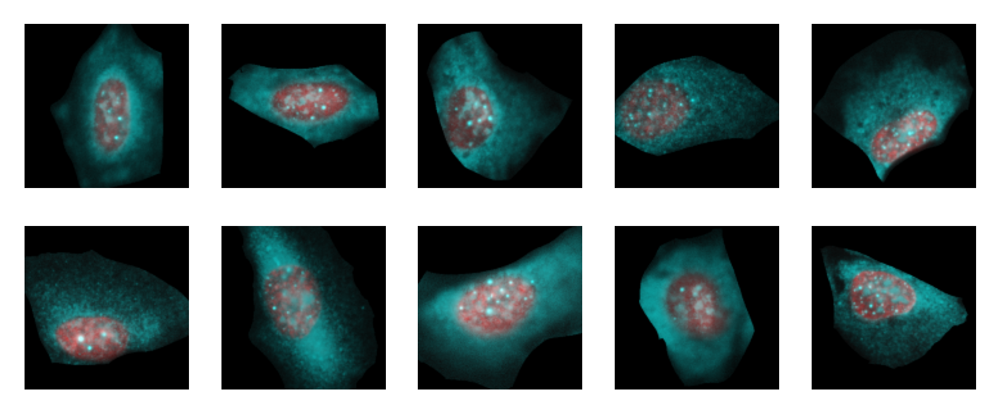

In [74]:
cluster_to_show = '2'

cell_ids_to_show = adata_p_single.obs[
    (adata_p_single.obs['protein'] == protein_to_show)
    &(adata_p_single.obs['leiden'] == cluster_to_show)]['cell_id'].values[:]

np.random.shuffle(cell_ids_to_show)
cell_ids_to_show = cell_ids_to_show[:10]

protein_id = channel_names.index(protein_to_show)
N_cells = len(cell_ids_to_show)

fig, axes = plt.subplots(2, 5, figsize=(5, 2), dpi=200)

for i in range(2):
    for j in range(5):
        cell_id = cell_ids_to_show[i * 5 + j]
        axes[i, j].imshow(np.array([dataset[cell_id][0][3], dataset[cell_id][0][protein_id], 
                    dataset[cell_id][0][protein_id]]).transpose(1, 2, 0))
        axes[i, j].set_axis_off()

# Differences among proteins and conditions

In [64]:
from sklearn.neighbors import NearestNeighbors


def estimate_KL_div_by_knn(X, Y, k=1):
    '''Estimate the KL-divergence by the KNN method.
    Args:
        X: (n, d) sample drawn from distribution P.
        Y: (m, d) sample drawn from distribution Q.
        k: Number of the nearest neighbor.
    Return:
        Estimated D(P|Q)
    '''
    
    # Calculate the distances
    x_nn = NearestNeighbors(n_neighbors=k + 1, algorithm="auto", n_jobs=-1).fit(X)
    y_nn = NearestNeighbors(n_neighbors=k, algorithm="auto", n_jobs=-1).fit(Y)
    
    dists_xx, _ = x_nn.kneighbors(X, k + 1, return_distance=True)
    dists_xy, _ = y_nn.kneighbors(X, k, return_distance=True)
    
    rho = dists_xx[:, -1]
    nu = dists_xy[:, -1]
    
    # Ignore the data points that encounter zero distances
    mask = (rho != 0) & (nu != 0)
    rho = rho[mask]
    nu = nu[mask]
    
    # Calculate the KL divergence
    n, m, d = len(rho), len(Y), len(X[0])

    kl_div =  d / n * np.sum(np.log(nu / rho)) + m / (n - 1)
    
    return kl_div

    
def estimate_J_div_by_knn(X, Y, k=1):
    '''Estimate the Jeffreys divergence by the KNN method'''
    return (estimate_KL_div_by_knn(X, Y, k=k) +  estimate_KL_div_by_knn(Y, X, k=k)) / 2

In [65]:
import deepmorph.analysis.distribution_comparison

In [66]:
# Calculate the protein similarity matrix
N_proteins = 37
protein_similarity_mtx = np.zeros((N_proteins, N_proteins), dtype=float)

for i in tqdm(range(N_proteins - 1)):    
    X = p_embedding[protein_ids == i]
    
    for j in range(i + 1, N_proteins):
        Y = p_embedding[protein_ids == j]
        
        div = deepmorph.analysis.distribution_comparison.estimate_J_div_by_knn(X, Y, k=10)
        protein_similarity_mtx[i, j] = div
        protein_similarity_mtx[j, i] = div

protein_similarity_df = pd.DataFrame(data=protein_similarity_mtx, 
                                     index=channel_names, columns=channel_names)

100%|██████████| 36/36 [14:39<00:00, 24.44s/it]


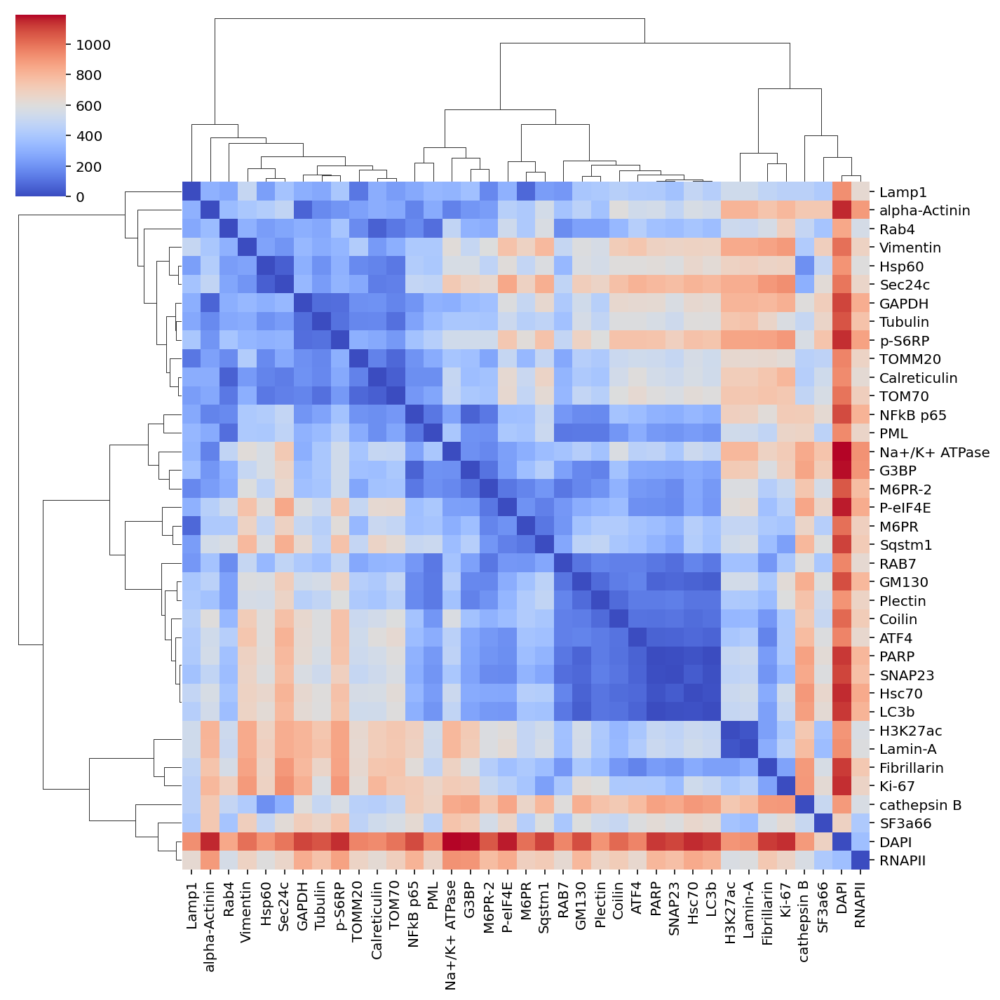

In [67]:
sns.clustermap(protein_similarity_df, cmap='coolwarm', method='average', metric='cosine')

In [68]:
# Calculate the distribution change matrix at different conditions
N_proteins = 37
N_conditions = len(dataset.categories)
control_id = 3
control_mask = condition_ids == control_id

protein_change_mtx = np.zeros((N_proteins, N_conditions), dtype=float)

for i in tqdm(range(N_proteins)): 
    protein_mask = protein_ids == i
    X = p_embedding[protein_mask * control_mask]
    
    for j in range(N_conditions):
        if j == control_id: continue
            
        condition_mask = condition_ids == j
        Y = p_embedding[protein_mask * condition_mask]
        div = deepmorph.analysis.distribution_comparison.estimate_J_div_by_knn(X, Y, k=10)
        protein_change_mtx[i, j] = div


protein_change_df = pd.DataFrame(data=protein_change_mtx, 
                                     index=channel_names, columns=dataset.categories)

100%|██████████| 37/37 [01:29<00:00,  2.43s/it]


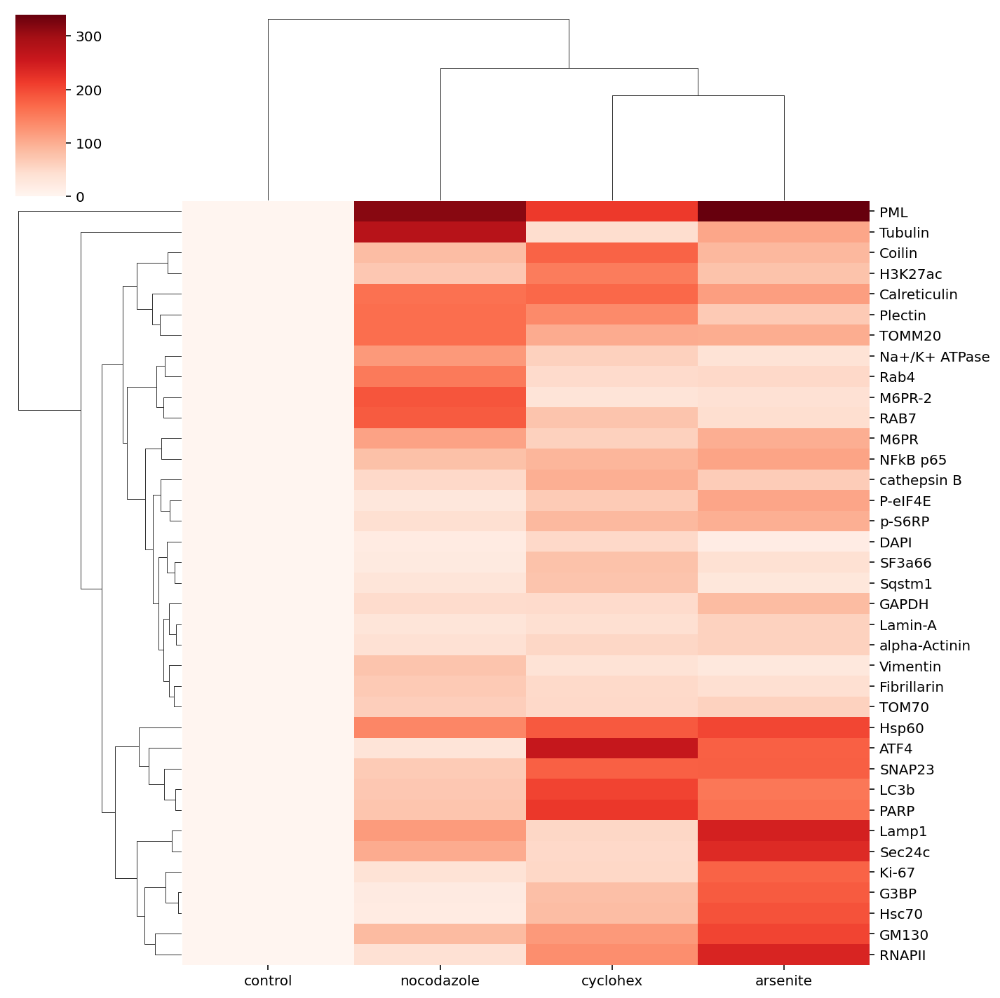

In [69]:
sns.clustermap(protein_change_df, cmap='Reds')

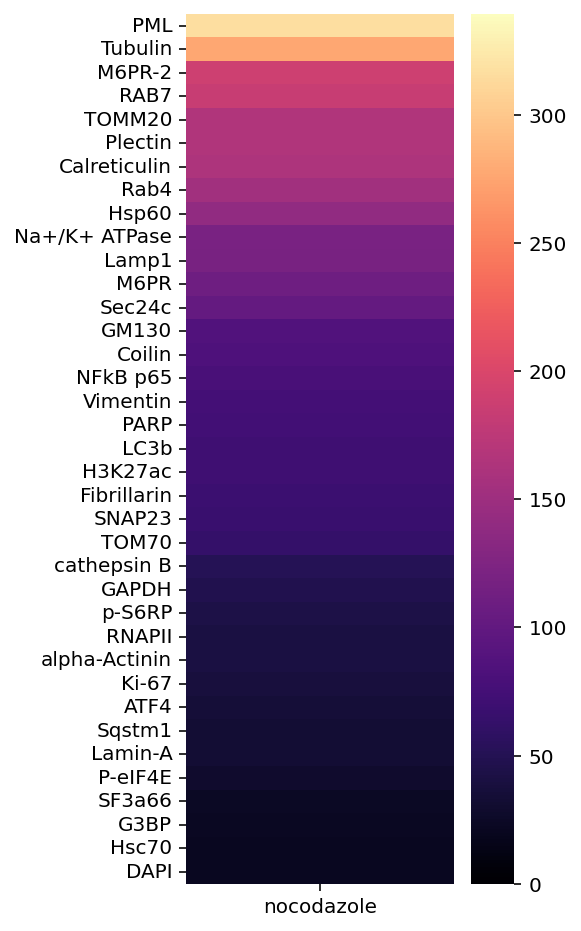

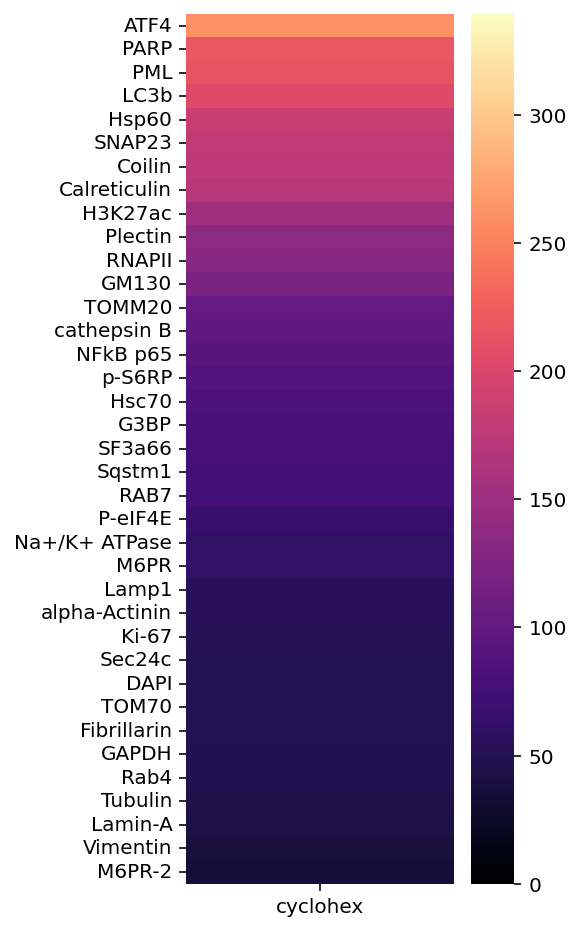

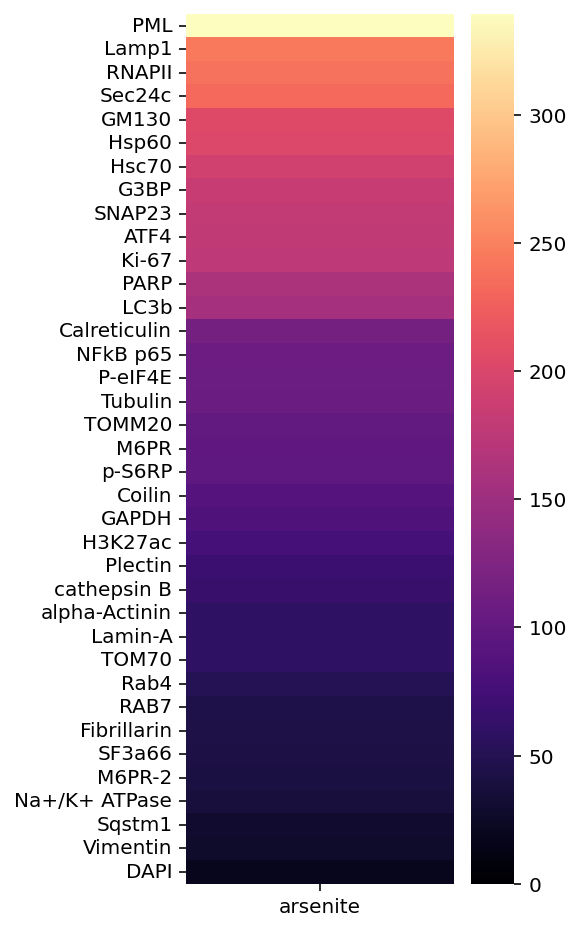

In [70]:
for c in ['nocodazole', 'cyclohex', 'arsenite']:

    fig, ax = plt.subplots(figsize=(3, 8))

    sns.heatmap(protein_change_df[[c]].sort_values(c, ascending=False), 
            cmap='magma', ax=ax, vmax=protein_change_df.values.max(), vmin=protein_change_df.values.min())

    plt.show()